<a href="https://colab.research.google.com/github/gregmoore24/gregmoore24/blob/main/GregMoore_Assignment5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Assignment 5.1 Video and Real-Time Analysis
### Greg Moore
### University of San Diego
### AAI-521: Applied Computer Vision for AI
### Professor Roozbeh Sadeghian, PhD.
### 11/25/2024

#### Link to Assignment 5.1 in Google Colab:

https://colab.research.google.com/drive/1zAcgO_AKb_w1PtHTpYz59kug9Is8gDk7#scrollTo=_NzVZ8Ni2SLg


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
#/content/gdrive/MyDrive/Colab Notebooks/

Mounted at /content/gdrive


### Part 1- Video read/write
Read a video in Python, and apply some basic tools on it. The video chosen for this part is from pixabay.com, a resource of free video/image and sound clips.

In [ ]:
# Load the libraries
from google.colab.patches import cv2_imshow
import cv2
import numpy as np
from IPython.display import HTML
from base64 import b64encode

### Part 1a) Read Bangkok.mp4 video
Read the file “Bangkok.mp4” file using OpenCV. Find the relevant commands to find the video’s metadata and print out the following information about the video: Frame Per second (fps), Total number of frames, Height, and Width of the video

In [ ]:
# Part 1a) Read the file “Bangkok.mp4” file using OpenCV. Find the relevant
# commands to find the video’s metadata and print out the following information
# about the video: Frame Per second (fps), Total number of frames, Height,
# and Width of the video.
# Access frames and properties of video
cap = cv2.VideoCapture('/content/gdrive/MyDrive/Colab Notebooks/Bangkok.mp4')
video_fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))

# Print information
print("\nVideo Information:")
print("Name of video: Bangkok.mp4")
print(f"Frames per second: {video_fps}")
print(f"Total frames: {total_frames}")
print(f"Height: {height}")
print(f"Width: {width}")



Video Information:
Name of video: Bangkok.mp4
Frames per second: 25.0
Total frames: 650
Height: 720
Width: 1280


### Part 1b) Play Bangkok.mp4 video
To play Bangkok.mp4 file inside Google Colab, use an embedded version using HTML library. For the rest of the steps, it would be easier to use HTML version for playing the video. Play the file ONLY using method 2 (HTML)

In [61]:
# Part 1b) To play Bangkok.mp4 file inside Google Colab, use an embedded version using
# HTML library. For the rest of the steps, it would be easier to use HTML
# version for playing the video.
# Play the file ONLY using method 2 (HTML)
video_path = '/content/gdrive/MyDrive/Colab Notebooks/Bangkok.mp4'
mp4 = open(video_path, 'rb').read()
decoded_vid = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f'<video width=400 controls><source src={decoded_vid} type="video/mp4"></video>')

### Create Video Writer

In [ ]:
# Create a video writer object to save video frames with specified properties
out_video_path = '/content/gdrive/MyDrive/Colab Notebooks/filtered_video.mp4'
# Defines the codec for video compression (X264 for MP4 format) 4 char string
fourcc = cv2.VideoWriter_fourcc(*'X264')
# Create object for saving frames
writer = cv2.VideoWriter(out_video_path, apiPreference=0, fourcc=fourcc,
                         fps=video_fps, frameSize=(int(width), int(height)))

### Part 1c) Create Sketch Version of Video and Display 3 Frames
Apply some filters on the video file. Use adaptive_theshold_mean and
threshold_binary_inv to create a sketch version of the video. Use the
Videowriter command to save the output, but it takes quite some time. Instead, only print 3 frames of the video.

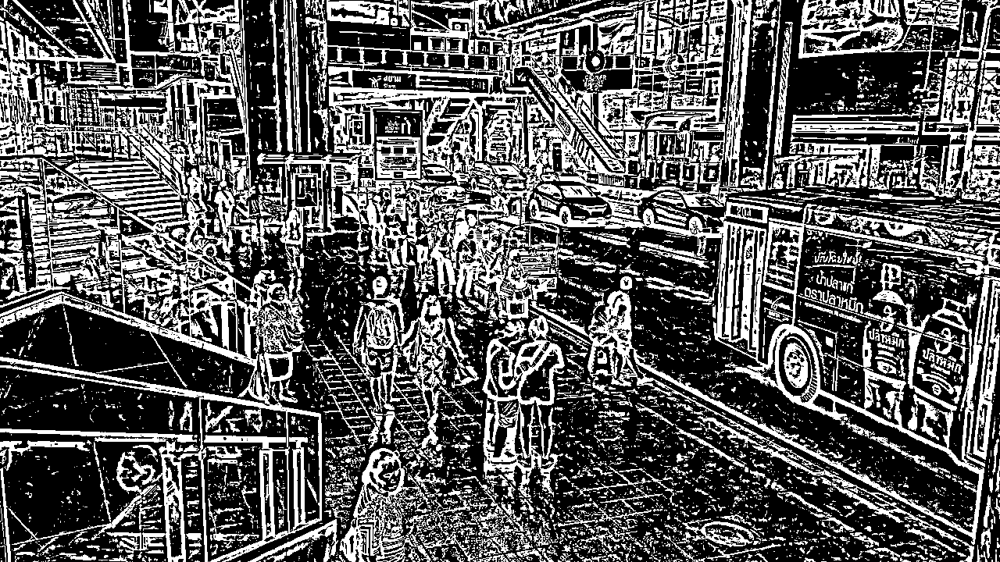

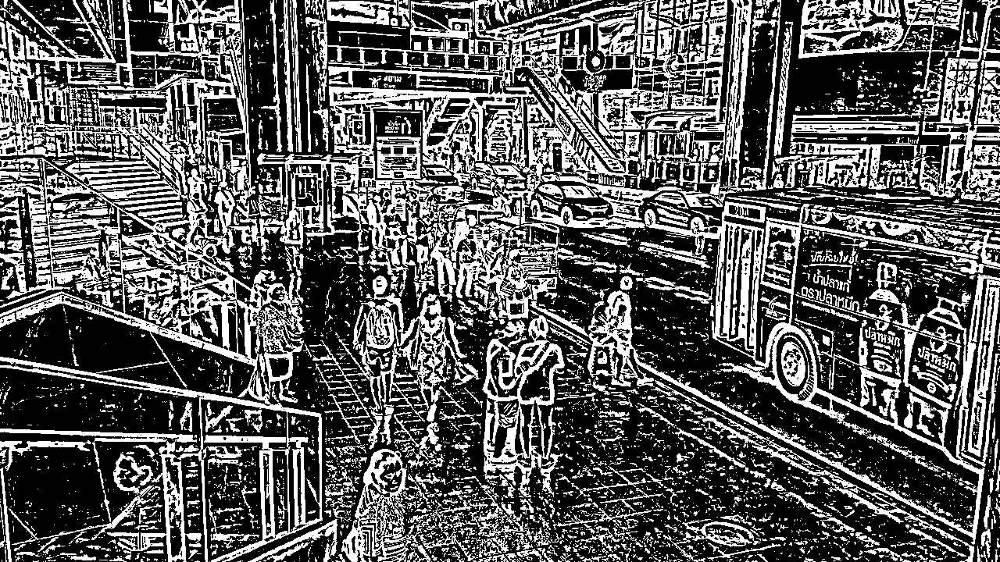

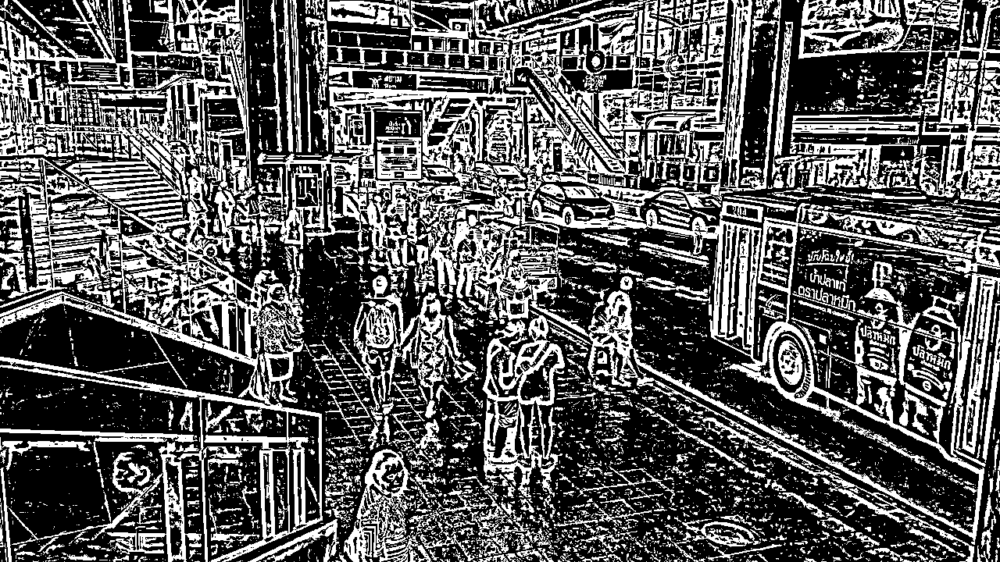

In [ ]:
# Part 1c) - Creating a VideoCapture object to read the video
# Save processed video frames to an MP4 file with the specified codec,
# resolution, and frame rate.
# Apply filters and display 3 frames
cap = cv2.VideoCapture('/content/gdrive/MyDrive/Colab Notebooks/Bangkok.mp4')
frame_count = 0

# Process the first three frames of video applying adaptive thresholding
while frame_count < 3:
    # Read the next frame from video
    ret, frame = cap.read()
    # Ensure valid frame was read
    if ret:
        # Convert the frame to grayscale
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        # Apply adaptive thresholding to the grayscale frame
        # Convert pixels to black/white based on their intensity relative to mean
        thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C,
                                       cv2.THRESH_BINARY_INV, 11, 2)
        # Display the thresholded frame in Colab
        cv2_imshow(thresh)
        frame_count += 1
    else:
        break

cap.release()
writer.release()
# Close any OpenCV-created windows
cv2.destroyAllWindows()

### Part 2 - Pose Estimation in Video
Return to the functions that were provided in previous assignments to estimate the pose in images. This time, we want to experience it in a video file. For that, we will follow the approach in https://github.com/tensorflow/hub/tree/master/examples and estimate the pose of the girl in video. The format of the video this time is gif.

In [ ]:
# Load all the libraries
import tensorflow as tf
import tensorflow_hub as hub
import numpy as np
import cv2
# Import matplotlib libraries
from matplotlib import pyplot as plt
from matplotlib.collections import LineCollection
import matplotlib.patches as patches
# Some modules to display an animation using imageio
import imageio
from IPython.display import HTML, display
from IPython.display import Image

###  Pose Estimation using MoveNet
Adapt to different model formats and variants, providing a unified interface for pose estimation using MoveNet. Load and execute the MoveNet model for pose estimation. It supports both TensorFlow Lite (TFLite) and TensorFlow Hub formats.

In [ ]:
# Load and execute the MoveNet model for pose estimation. It supports both
# TensorFlow Lite (TFLite) and TensorFlow Hub formats.
model_name = "movenet_lightning"

# Support "lightning" (faster) and "thunder" (more accurate) variants,
# as well as different quantization levels (float16, int8)
if "tflite" in model_name:
  if "movenet_lightning_f16" in model_name:
    !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/lightning/tflite/float16/4?lite-format=tflite
    input_size = 192
  elif "movenet_thunder_f16" in model_name:
    !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/thunder/tflite/float16/4?lite-format=tflite
    input_size = 256
  elif "movenet_lightning_int8" in model_name:
    !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/lightning/tflite/int8/4?lite-format=tflite
    input_size = 192
  elif "movenet_thunder_int8" in model_name:
    !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/thunder/tflite/int8/4?lite-format=tflite
    input_size = 256
  else:
    raise ValueError("Unsupported model name: %s" % model_name)

  # Initialize the TFLite interpreter
  interpreter = tf.lite.Interpreter(model_path="model.tflite")
  interpreter.allocate_tensors()

  # Use an inference function
  def movenet(input_image):
    """Runs detection on an input image.

    Args:
      input_image: A [1, height, width, 3] tensor represents the input image
        pixels. Note that the height/width should already be resized and match the
        expected input resolution of the model before passing into this function.

    Returns:
      A [1, 1, 17, 3] float numpy array representing the predicted keypoint
      coordinates and scores.
    """
    # TF Lite format expects tensor type of uint8
    input_image = tf.cast(input_image, dtype=tf.uint8)
    input_details = interpreter.get_input_details()
    output_details = interpreter.get_output_details()
    interpreter.set_tensor(input_details[0]['index'], input_image.numpy())
    # Invoke inference
    interpreter.invoke()
    # Get the model prediction
    keypoints_with_scores = interpreter.get_tensor(output_details[0]['index'])
    return keypoints_with_scores

else:
  if "movenet_lightning" in model_name:
    module = hub.load("https://tfhub.dev/google/movenet/singlepose/lightning/4")
    input_size = 192
  elif "movenet_thunder" in model_name:
    module = hub.load("https://tfhub.dev/google/movenet/singlepose/thunder/4")
    input_size = 256
  else:
    raise ValueError("Unsupported model name: %s" % model_name)

  def movenet(input_image):
    """Runs detection on an input image.

    Args:
      input_image: A [1, height, width, 3] tensor represents the input image
        pixels. Note that the height/width should already be resized and match the
        expected input resolution of the model before passing into this function.

    Returns:
      A [1, 1, 17, 3] float numpy array representing the predicted keypoint
      coordinates and scores.
    """
    model = module.signatures['serving_default']

    # SavedModel format expects tensor type of int32
    input_image = tf.cast(input_image, dtype=tf.int32)
    # Run model inference
    outputs = model(input_image)
    # Output is a [1, 1, 17, 3] tensor
    keypoints_with_scores = outputs['output_0'].numpy()
    return keypoints_with_scores

### Download the dance.gif File for Pose Estimation Processing

In [ ]:
import tensorflow as tf
import urllib.request

# Download the GIF file
url = 'https://github.com/tensorflow/tfjs-models/raw/master/pose-detection/assets/dance_input.gif'
urllib.request.urlretrieve(url, 'dance.gif')

('dance.gif', <http.client.HTTPMessage at 0x78221d00d750>)

### Load and Decode dance.gif File

In [ ]:
# Load the input image
image_path = 'dance.gif'
# Use TensorFlow's I/O operations to read the contents of the file
image = tf.io.read_file(image_path)
# Decode the GIF file content into a tensor
image = tf.image.decode_gif(image)

### Implement Pipeline for dance.gif Using MoveNet Pose Estimation model
All code given and used as is.

In [ ]:
# All the required code is put in this cell you don't need to modify anything
# in this cell. Confidence score to determine whether a keypoint prediction is
# reliable
MIN_CROP_KEYPOINT_SCORE = 0.2

KEYPOINT_DICT = {
    'nose': 0,
    'left_eye': 1,
    'right_eye': 2,
    'left_ear': 3,
    'right_ear': 4,
    'left_shoulder': 5,
    'right_shoulder': 6,
    'left_elbow': 7,
    'right_elbow': 8,
    'left_wrist': 9,
    'right_wrist': 10,
    'left_hip': 11,
    'right_hip': 12,
    'left_knee': 13,
    'right_knee': 14,
    'left_ankle': 15,
    'right_ankle': 16
}

KEYPOINT_EDGE_INDS_TO_COLOR = {
    (0, 1): 'm',
    (0, 2): 'c',
    (1, 3): 'm',
    (2, 4): 'c',
    (0, 5): 'm',
    (0, 6): 'c',
    (5, 7): 'm',
    (7, 9): 'm',
    (6, 8): 'c',
    (8, 10): 'c',
    (5, 6): 'y',
    (5, 11): 'm',
    (6, 12): 'c',
    (11, 12): 'y',
    (11, 13): 'm',
    (13, 15): 'm',
    (12, 14): 'c',
    (14, 16): 'c'
}
def init_crop_region(image_height, image_width):
  """Defines the default crop region.

  The function provides the initial crop region (pads the full image from both
  sides to make it a square image) when the algorithm cannot reliably determine
  the crop region from the previous frame.
  """
  if image_width > image_height:
    box_height = image_width / image_height
    box_width = 1.0
    y_min = (image_height / 2 - image_width / 2) / image_height
    x_min = 0.0
  else:
    box_height = 1.0
    box_width = image_height / image_width
    y_min = 0.0
    x_min = (image_width / 2 - image_height / 2) / image_width

  return {
    'y_min': y_min,
    'x_min': x_min,
    'y_max': y_min + box_height,
    'x_max': x_min + box_width,
    'height': box_height,
    'width': box_width
  }

def torso_visible(keypoints):
  """Checks whether there are enough torso keypoints.

  This function checks whether the model is confident at predicting one of the
  shoulders/hips which is required to determine a good crop region.
  """
  return ((keypoints[0, 0, KEYPOINT_DICT['left_hip'], 2] >
           MIN_CROP_KEYPOINT_SCORE or
          keypoints[0, 0, KEYPOINT_DICT['right_hip'], 2] >
           MIN_CROP_KEYPOINT_SCORE) and
          (keypoints[0, 0, KEYPOINT_DICT['left_shoulder'], 2] >
           MIN_CROP_KEYPOINT_SCORE or
          keypoints[0, 0, KEYPOINT_DICT['right_shoulder'], 2] >
           MIN_CROP_KEYPOINT_SCORE))


def _keypoints_and_edges_for_display(keypoints_with_scores,
                                     height,
                                     width,
                                     keypoint_threshold=0.11):
  """Returns high confidence keypoints and edges for visualization.

  Args:
    keypoints_with_scores: A numpy array with shape [1, 1, 17, 3] representing
      the keypoint coordinates and scores returned from the MoveNet model.
    height: height of the image in pixels.
    width: width of the image in pixels.
    keypoint_threshold: minimum confidence score for a keypoint to be
      visualized.

  Returns:
    A (keypoints_xy, edges_xy, edge_colors) containing:
      * the coordinates of all keypoints of all detected entities;
      * the coordinates of all skeleton edges of all detected entities;
      * the colors in which the edges should be plotted.
  """
  keypoints_all = []
  keypoint_edges_all = []
  edge_colors = []
  num_instances, _, _, _ = keypoints_with_scores.shape
  for idx in range(num_instances):
    kpts_x = keypoints_with_scores[0, idx, :, 1]
    kpts_y = keypoints_with_scores[0, idx, :, 0]
    kpts_scores = keypoints_with_scores[0, idx, :, 2]
    kpts_absolute_xy = np.stack(
        [width * np.array(kpts_x), height * np.array(kpts_y)], axis=-1)
    kpts_above_thresh_absolute = kpts_absolute_xy[
        kpts_scores > keypoint_threshold, :]
    keypoints_all.append(kpts_above_thresh_absolute)

    for edge_pair, color in KEYPOINT_EDGE_INDS_TO_COLOR.items():
      if (kpts_scores[edge_pair[0]] > keypoint_threshold and
          kpts_scores[edge_pair[1]] > keypoint_threshold):
        x_start = kpts_absolute_xy[edge_pair[0], 0]
        y_start = kpts_absolute_xy[edge_pair[0], 1]
        x_end = kpts_absolute_xy[edge_pair[1], 0]
        y_end = kpts_absolute_xy[edge_pair[1], 1]
        line_seg = np.array([[x_start, y_start], [x_end, y_end]])
        keypoint_edges_all.append(line_seg)
        edge_colors.append(color)
  if keypoints_all:
    keypoints_xy = np.concatenate(keypoints_all, axis=0)
  else:
    keypoints_xy = np.zeros((0, 17, 2))

  if keypoint_edges_all:
    edges_xy = np.stack(keypoint_edges_all, axis=0)
  else:
    edges_xy = np.zeros((0, 2, 2))
  return keypoints_xy, edges_xy, edge_colors


def progress(value, max=100):
  return HTML("""
      <progress
          value='{value}'
          max='{max}',
          style='width: 100%'
      >
          {value}
      </progress>
  """.format(value=value, max=max))

def crop_and_resize(image, crop_region, crop_size):
  """Crops and resize the image to prepare for the model input."""
  boxes=[[crop_region['y_min'], crop_region['x_min'],
          crop_region['y_max'], crop_region['x_max']]]
  output_image = tf.image.crop_and_resize(
      image, box_indices=[0], boxes=boxes, crop_size=crop_size)
  return output_image

def run_inference(movenet, image, crop_region, crop_size):
  """Runs model inferece on the cropped region.

  The function runs the model inference on the cropped region and updates the
  model output to the original image coordinate system.
  """
  image_height, image_width, _ = image.shape
  input_image = crop_and_resize(
    tf.expand_dims(image, axis=0), crop_region, crop_size=crop_size)
  # Run model inference.
  keypoints_with_scores = movenet(input_image)
  # Update the coordinates.
  for idx in range(17):
    keypoints_with_scores[0, 0, idx, 0] = (
        crop_region['y_min'] * image_height +
        crop_region['height'] * image_height *
        keypoints_with_scores[0, 0, idx, 0]) / image_height
    keypoints_with_scores[0, 0, idx, 1] = (
        crop_region['x_min'] * image_width +
        crop_region['width'] * image_width *
        keypoints_with_scores[0, 0, idx, 1]) / image_width
  return keypoints_with_scores

def draw_prediction_on_image(
    image, keypoints_with_scores, crop_region=None, close_figure=False,
    output_image_height=None):
  """Draws the keypoint predictions on image.

  Args:
    image: A numpy array with shape [height, width, channel] representing the
      pixel values of the input image.
    keypoints_with_scores: A numpy array with shape [1, 1, 17, 3] representing
      the keypoint coordinates and scores returned from the MoveNet model.
    crop_region: A dictionary that defines the coordinates of the bounding box
      of the crop region in normalized coordinates (see the init_crop_region
      function below for more detail). If provided, this function will also
      draw the bounding box on the image.
    output_image_height: An integer indicating the height of the output image.
      Note that the image aspect ratio will be the same as the input image.

  Returns:
    A numpy array with shape [out_height, out_width, channel] representing the
    image overlaid with keypoint predictions.
  """
  height, width, channel = image.shape
  aspect_ratio = float(width) / height
  fig, ax = plt.subplots(figsize=(12 * aspect_ratio, 12))
  # To remove the huge white borders
  fig.tight_layout(pad=0)
  ax.margins(0)
  ax.set_yticklabels([])
  ax.set_xticklabels([])
  plt.axis('off')

  im = ax.imshow(image)
  line_segments = LineCollection([], linewidths=(4), linestyle='solid')
  ax.add_collection(line_segments)
  # Turn off tick labels
  scat = ax.scatter([], [], s=60, color='#FF1493', zorder=3)

  (keypoint_locs, keypoint_edges,
   edge_colors) = _keypoints_and_edges_for_display(
       keypoints_with_scores, height, width)

  line_segments.set_segments(keypoint_edges)
  line_segments.set_color(edge_colors)
  if keypoint_edges.shape[0]:
    line_segments.set_segments(keypoint_edges)
    line_segments.set_color(edge_colors)
  if keypoint_locs.shape[0]:
    scat.set_offsets(keypoint_locs)

  if crop_region is not None:
    xmin = max(crop_region['x_min'] * width, 0.0)
    ymin = max(crop_region['y_min'] * height, 0.0)
    rec_width = min(crop_region['x_max'], 0.99) * width - xmin
    rec_height = min(crop_region['y_max'], 0.99) * height - ymin
    rect = patches.Rectangle(
        (xmin,ymin),rec_width,rec_height,
        linewidth=1,edgecolor='b',facecolor='none')
    ax.add_patch(rect)

  fig.canvas.draw()
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
  image_from_plot = image_from_plot.reshape(
      fig.canvas.get_width_height()[::-1] + (3,))
  plt.close(fig)
  if output_image_height is not None:
    output_image_width = int(output_image_height / height * width)
    image_from_plot = cv2.resize(
        image_from_plot, dsize=(output_image_width, output_image_height),
         interpolation=cv2.INTER_CUBIC)
  return image_from_plot

def determine_crop_region(
      keypoints, image_height,
      image_width):
  """Determines the region to crop the image for the model to run inference on.

  The algorithm uses the detected joints from the previous frame to estimate
  the square region that encloses the full body of the target person and
  centers at the midpoint of two hip joints. The crop size is determined by
  the distances between each joints and the center point.
  When the model is not confident with the four torso joint predictions, the
  function returns a default crop which is the full image padded to square.
  """
  target_keypoints = {}
  for joint in KEYPOINT_DICT.keys():
    target_keypoints[joint] = [
      keypoints[0, 0, KEYPOINT_DICT[joint], 0] * image_height,
      keypoints[0, 0, KEYPOINT_DICT[joint], 1] * image_width
    ]

  if torso_visible(keypoints):
    center_y = (target_keypoints['left_hip'][0] +
                target_keypoints['right_hip'][0]) / 2;
    center_x = (target_keypoints['left_hip'][1] +
                target_keypoints['right_hip'][1]) / 2;

    (max_torso_yrange, max_torso_xrange,
      max_body_yrange, max_body_xrange) = determine_torso_and_body_range(
          keypoints, target_keypoints, center_y, center_x)

    crop_length_half = np.amax(
        [max_torso_xrange * 1.9, max_torso_yrange * 1.9,
          max_body_yrange * 1.2, max_body_xrange * 1.2])

    tmp = np.array(
        [center_x, image_width - center_x, center_y, image_height - center_y])
    crop_length_half = np.amin(
        [crop_length_half, np.amax(tmp)]);

    crop_corner = [center_y - crop_length_half, center_x - crop_length_half];

    if crop_length_half > max(image_width, image_height) / 2:
      return init_crop_region(image_height, image_width)
    else:
      crop_length = crop_length_half * 2;
      return {
        'y_min': crop_corner[0] / image_height,
        'x_min': crop_corner[1] / image_width,
        'y_max': (crop_corner[0] + crop_length) / image_height,
        'x_max': (crop_corner[1] + crop_length) / image_width,
        'height': (crop_corner[0] + crop_length) / image_height -
            crop_corner[0] / image_height,
        'width': (crop_corner[1] + crop_length) / image_width -
            crop_corner[1] / image_width
      }
  else:
    return init_crop_region(image_height, image_width)

def determine_torso_and_body_range(
    keypoints, target_keypoints, center_y, center_x):
  """Calculates the maximum distance from each keypoints to the center location.

  The function returns the maximum distances from the two sets of keypoints:
  full 17 keypoints and 4 torso keypoints. The returned information will be
  used to determine the crop size. See determineCropRegion for more detail.
  """
  torso_joints = ['left_shoulder', 'right_shoulder', 'left_hip', 'right_hip']
  max_torso_yrange = 0.0
  max_torso_xrange = 0.0
  for joint in torso_joints:
    dist_y = abs(center_y - target_keypoints[joint][0])
    dist_x = abs(center_x - target_keypoints[joint][1])
    if dist_y > max_torso_yrange:
      max_torso_yrange = dist_y
    if dist_x > max_torso_xrange:
      max_torso_xrange = dist_x

  max_body_yrange = 0.0
  max_body_xrange = 0.0
  for joint in KEYPOINT_DICT.keys():
    if keypoints[0, 0, KEYPOINT_DICT[joint], 2] < MIN_CROP_KEYPOINT_SCORE:
      continue
    dist_y = abs(center_y - target_keypoints[joint][0]);
    dist_x = abs(center_x - target_keypoints[joint][1]);
    if dist_y > max_body_yrange:
      max_body_yrange = dist_y

    if dist_x > max_body_xrange:
      max_body_xrange = dist_x

  return [max_torso_yrange, max_torso_xrange, max_body_yrange, max_body_xrange]

def to_gif(images, fps):
  """Converts image sequence (4D numpy array) to gif."""
  imageio.mimsave('./animation.gif', images, fps=fps)


def progress(value, max=100):
  return HTML("""
      <progress
          value='{value}'
          max='{max}',
          style='width: 100%'
      >
          {value}
      </progress>
  """.format(value=value, max=max))

### Process dance.gif image Using MoveNet and Display Results

<ipython-input-17-185363b0b2e4>:247: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
<ipython-input-17-185363b0b2e4>:247: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
<ipython-input-17-185363b0b2e4>:247: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
<ipython-input-17-185363b0b2e4>:247: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use bu

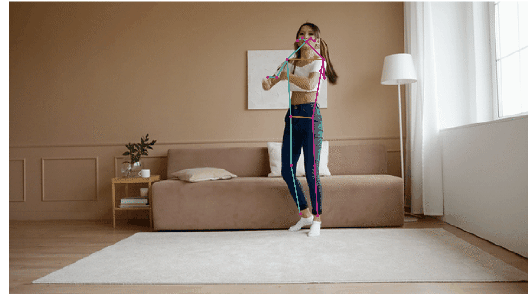

In [ ]:
# Get shape of dance.gif image (num_frames, height, width, channels)
num_frames, image_height, image_width, _ = image.shape
# Initialize crop region
crop_region = init_crop_region(image_height, image_width)

output_images = []
# Progress bar
bar = display(progress(0, num_frames-1), display_id=True)

# Loop for each frame to detect keypoints and draw them on the image
for frame_idx in range(num_frames):
    # Run inference on the current frame
    keypoints_with_scores = run_inference(
        movenet, image[frame_idx, :, :, :], crop_region,
        crop_size=[input_size, input_size])
    output_images.append(draw_prediction_on_image(
        # Convert tensor to numpy and draw keypoints
        image[frame_idx, :, :, :].numpy().astype(np.int32),
        keypoints_with_scores, crop_region=None,
        # Resize image to standard height
        close_figure=True, output_image_height=300))
    # Update crop region based on detected keypoints
    crop_region = determine_crop_region(
        keypoints_with_scores, image_height, image_width)
    # Update progress bar
    bar.update(progress(frame_idx, num_frames-1))

# Prepare gif visualization.
output = np.stack(output_images, axis=0)  # Stack all frames into a numpy array
to_gif(output, fps=10)  # Convert frames to gif (fps can be adjusted)

# Display generated .gif
display(Image(filename='./animation.gif'))

### Part 3 - Using Webcam Video
Use a webcam and make object detection in real time. As you have seen in
previous modules, the first step is to have a pre-trained model and use it for future classifications. My recommendation is to use the YOLO8 model for this part (yolov8n.pt). Another piece that we need is a script to connect our webcam to Python to make a live object detection application. We will be using the code snippet for Camera Capture which runs JavaScript code to utilize your computer's webcam. Please refer to the previous assignment to copy the code here. Design code that can detect the objects in real-time while you are seeing the video on Notebook. Use code to detect the camera and take a photo, and finally detect the objects in the photo.

### Step 1 - Install Libraries

In [ ]:
# Step 1: Install necessary libraries
!pip install torch torchvision torchaudio
!pip install ultralytics
!pip install ipywidgets

### Load Libraries

In [54]:
# Load Required libraries
import cv2
import numpy as np
import torch
import requests
import ipywidgets as widgets
from IPython.display import display, Javascript
from google.colab.output import eval_js
import base64
from io import BytesIO
from PIL import Image
from ultralytics import YOLO

### Step 2 - Load Pre-trained YOLOv8 Model

In [55]:
# Step 2 - Load pre-trained YOLOv8 model nano
model = YOLO('yolov8n.pt')

### Step 3 - Function to Detect Objects Using YOLOv8

In [56]:
# Step 3: Function to detect objects using YOLOv8
def detect_objects(frame):
    results = model(frame)
    annotated_frame = results[0].plot()
    return annotated_frame

### Step 4 - JavaScript to Capture Video from Webcam

In [57]:
# Step 4: JavaScript to capture video from webcam
def capture_video():
    display(Javascript('''
        async function captureVideo() {
            const video = document.createElement('video');
            const canvas = document.createElement('canvas');
            const context = canvas.getContext('2d');
            document.body.appendChild(video);
            video.style.display = 'none';
            const stream = await navigator.mediaDevices.getUserMedia({video: true});
            video.srcObject = stream;
            await new Promise((resolve) => video.onloadedmetadata = resolve);
            video.play();

            const [track] = stream.getVideoTracks();
            const settings = track.getSettings();
            canvas.width = settings.width;
            canvas.height = settings.height;

            async function stopVideo() {
                stream.getTracks().forEach(track => track.stop());
                video.remove();
                canvas.remove();
            }

            window.stopVideo = stopVideo;

            while (true) {
                context.drawImage(video, 0, 0, canvas.width, canvas.height);
                const imageData = canvas.toDataURL('image/jpeg', 0.8);
                const response = await google.colab.kernel.invokeFunction('notebook.getFrame', [imageData], {});
                if (response.data.result === 'quit') break;
                await new Promise((resolve) => setTimeout(resolve, 100));
            }

            stream.getTracks().forEach(track => track.stop());
            video.remove();
            canvas.remove();
        }
        captureVideo();
    '''))

### Step 5 - Python Callback to Process Frames

In [58]:
# Step 5: Python callback to process frames
processing = True
# Check for Stop Button pushed
def get_frame(image_data):
    global processing
    if not processing:
        return {'result': 'quit'}
    try:
        # Decode the base64 image
        image_data = image_data.split(",")[1]
        image_bytes = base64.b64decode(image_data)
        image = Image.open(BytesIO(image_bytes))
        frame = np.array(image)
        # Convert to RGB and detect objects
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame_detected = detect_objects(frame_rgb)
        # Save the frame as a JPEG file
        cv2.imwrite("/content/gdrive/MyDrive/Colab Notebooks/detected_frame.jpg", frame_detected)
        # Encode and display the frame
        _, img_encoded = cv2.imencode('.jpg', frame_detected)
        image_widget.value = img_encoded.tobytes()
        return {'result': 'continue'}
    except Exception as e:
        print(f"Error processing frame: {e}")
        return {'result': 'error'}


### Step 6 - Register Callback Function and Display Video Stream for Live Object Detection
Image below is from real-time object detection while seeing thge video on Notebook.

In [59]:
# Register the Python callback function
from google.colab import output
output.register_callback('notebook.getFrame', get_frame)

# Step 6: Widget to display the video stream
image_widget = widgets.Image(format='jpeg')
display(image_widget)


Image(value=b'', format='jpeg')

### Step 7 - Add Stop Button Functionality

In [51]:
# Step 7: Stop button functionality otherwise constantly the video will be shown
def stop_video(change):
    eval_js('window.stopVideo()')
    # Return quit signal for the loop
    global processing
    processing = False

    return {'result': 'quit'}

### Display Stop Button and Detect Objects in Real-Time

In [53]:
# Display Stop Button
stop_button = widgets.Button(description="Stop Video")
stop_button.on_click(stop_video)
display(stop_button)

# Capture Video from the Webcam
capture_video()

Button(description='Stop Video', style=ButtonStyle())

<IPython.core.display.Javascript object>


0: 480x640 2 persons, 189.0ms
Speed: 2.6ms preprocess, 189.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 persons, 181.0ms
Speed: 2.9ms preprocess, 181.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 persons, 194.8ms
Speed: 3.4ms preprocess, 194.8ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 persons, 180.3ms
Speed: 3.5ms preprocess, 180.3ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 persons, 188.9ms
Speed: 2.9ms preprocess, 188.9ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 persons, 1 scissors, 265.9ms
Speed: 3.0ms preprocess, 265.9ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 persons, 1 scissors, 289.3ms
Speed: 2.8ms preprocess, 289.3ms inference, 3.1ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 2 persons, 1 scissors, 284.6ms
Speed: 2.9ms preprocess, 284.6

### Capture one Image from Live Object Detection Stream and Display

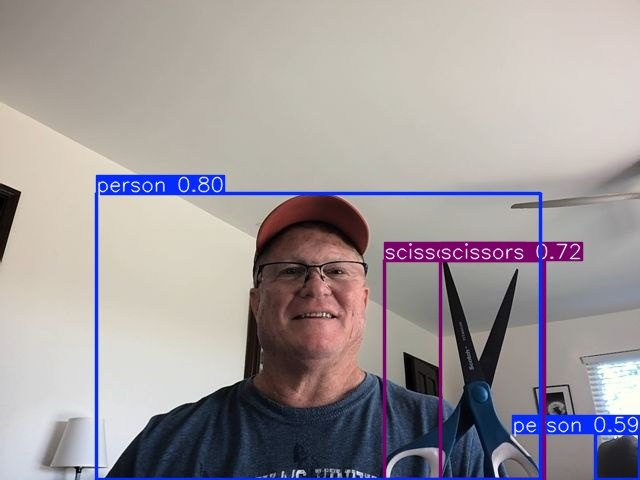

In [60]:
from IPython.display import Image as IPImage, display
display(IPImage("/content/gdrive/MyDrive/Colab Notebooks/detected_frame.jpg"))